# Stable Diffusion Prompt Editing

This notebook is an exploration of how you can edit specific elements of an already generated image (for which you have the seed) by providing a secondary prompt. For example, have an image generated for "cat riding a bicycle", and wanting to change that particular image to have a dog instead by specifying "dog riding a bicycle" instead.

There are several papers on this subject already such a [Imagic](https://arxiv.org/abs/2210.09276), [Cross Attention Control](https://arxiv.org/abs/2208.01626), [Re-Imagen](https://arxiv.org/abs/2209.14491), and [UniTune](https://arxiv.org/abs/2210.09477) but I don't understand the math there enough to be able to try to implement one of those approaches yet. 

So this is my effort to try and understand if perhaps prompt editing can be implemented a differnet way (with my limited understanding) so as to retain all the characteristics of the original image except for the desired modifications.

In [68]:
import random
import torch
from transformers import CLIPTextModel, CLIPTokenizer
from transformers import logging
from diffusers import AutoencoderKL, UNet2DConditionModel, LMSDiscreteScheduler
from tqdm.auto import tqdm
from torch import autocast
from PIL import Image
from matplotlib import pyplot as plt
import numpy
import warnings
from torchvision import transforms as tfms
from typing import List
from textwrap import wrap

# For video display:
from IPython.display import HTML
from base64 import b64encode

# Not a best practice but adding ignoring warnings to remove constant macOS warnings about MPS
warnings.filterwarnings("ignore")

# Supress some unnecessary warnings when loading the CLIPTextModel
logging.set_verbosity_error()

# Set device
cast_device = "cuda" if torch.cuda.is_available() else "cpu"
torch_device = "cuda" if torch.cuda.is_available() else "mps" if torch.has_mps else "cpu"

In [3]:
# Load the autoencoder model which will be used to decode the latents into image space. 
vae = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae")

# Load the tokenizer and text encoder to tokenize and encode the text. 
tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14")
text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14")

# The UNet model for generating the latents.
unet = UNet2DConditionModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="unet")

# Attention slicing - improves performance on macOS
if torch.has_mps:
    slice_size = unet.config.attention_head_dim // 2
    unet.set_attention_slice(slice_size)

# The noise scheduler
scheduler = LMSDiscreteScheduler(beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", num_train_timesteps=1000)

# To the GPU we go!
vae = vae.to(torch_device)
text_encoder = text_encoder.to(torch_device)
unet = unet.to(torch_device)

In [56]:
# Utility functions
def image_from_latents(latents):
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    # Create PIL image
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    images = (image * 255).round().astype("uint8")
    img = Image.fromarray(images[0])
    return img
    
def show_image(image, seed, scale_by=0.5):
    print(f'Seed: {seed}')
    img = image.resize(((int)(image.width * scale_by), (int)(image.height * scale_by)))
    display(img)
    return img

In [5]:
# First iteration of the image generator - we'll create new versions later on
def generate(text_embeddings, width=512, height=512, steps=50, guidance=7.5, seed=None):
    # Do we have a seed?
    if seed is None:
        seed = random.randrange(2 ** 32 - 1)
    generator = torch.manual_seed(seed)
    
    # Prep text 
    uc_input = tokenizer([""], padding="max_length", max_length=tokenizer.model_max_length, 
        return_tensors="pt")
    with torch.no_grad():
        unconditioned = text_encoder(uc_input.input_ids.to(torch_device))[0]

    text_embeddings = torch.cat([unconditioned, text_embeddings])

    # Prep Scheduler
    scheduler.set_timesteps(steps)

    # Prep latents
    latents = torch.randn((1, unet.in_channels, height // 8, width // 8), generator=generator)
    latents = latents.to(torch_device)
    latents = latents * scheduler.init_noise_sigma

    # Loop
    with autocast(cast_device):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            # Expand the latents to avoid doing two forward passes
            model_input = torch.cat([latents] * 2)
            sigma = scheduler.sigmas[i]
            # Scale the latents
            model_input = scheduler.scale_model_input(model_input, t)

            # Predict the noise residual
            with torch.no_grad():
                ts = t
                if torch.has_mps:
                    ts = ts.type(torch.float32)
                noise_pred = unet(model_input, ts, encoder_hidden_states=text_embeddings).sample

            # Perform guidance
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance * (noise_pred_text - noise_pred_uncond)

            # Compute the previous noisy sample x_t -> x_t-1
            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # Get PIL image
    image = image_from_latents(latents)
    return image, seed

In [5]:
prompt = "a cat riding a bicycle, highly detailed, trending on artstation, colorful"
text_input = tokenizer(prompt, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
with torch.no_grad():
    text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]

Seed: 1234693494


0it [00:00, ?it/s]

Seed: 1234693494


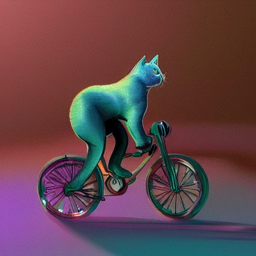

In [25]:
image, seed = generate(text_embeddings)
show_image(image, seed)

The above output was for the prompt `a cat riding a bicycle, highly detailed, trending on artstation, colorful`. Now let's break down that prompt:

In [6]:
# What happens when you tokenize the prompt?
text_input = tokenizer(prompt, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
text_input, text_input.input_ids.verbose, text_input.attention_mask.verbose

({'input_ids': tensor[1, 77] n=77 x∈[267.000, 4.941e+04] μ=4.059e+04 σ=1.815e+04 int64 x=..., 'attention_mask': tensor[1, 77] n=77 x∈[0., 1.000] μ=0.221 σ=0.417 int64 x=...},
 tensor[1, 77] n=77 x∈[267.000, 4.941e+04] μ=4.059e+04 σ=1.815e+04 int64
 x=[[49406,   320,  2368,  6765,   320, 11652,   267,  5302, 12609,   267,  6087,
       525,  1486,  2631,   267, 11444, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407]],
 tensor[1, 77] n=77 x∈[0., 1.000] μ=0.221 σ=0.417 int64
 x=[[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
     0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [7]:
text_input['input_ids'][0][0].item()

49406

In [8]:
# The 'input_ids' hold the tokens as numeric values. We can convert them back to textual values
# The start-of-text token is 49406 and end-of-text token is 49407. We will output tokens till end-of-text
text_start = 49406
text_end = 49407
for id in text_input['input_ids'][0]:
    token = id.item()
    if token == text_end:
        break
    print(f"{token}", tokenizer.convert_ids_to_tokens(token))

49406 <|startoftext|>
320 a</w>
2368 cat</w>
6765 riding</w>
320 a</w>
11652 bicycle</w>
267 ,</w>
5302 highly</w>
12609 detailed</w>
267 ,</w>
6087 trending</w>
525 on</w>
1486 art
2631 station</w>
267 ,</w>
11444 colorful</w>


In [9]:
# The above tokens are converted too text embeddings by the text encoder. What do the embeddings look like?
text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
text_embeddings.verbose

tensor[1, 77, 768] n=59136 x∈[-28.091, 33.063] μ=-0.111 σ=1.032 grad_fn mps:0
x=[[[-0.3884,  0.0229, -0.0522,  ..., -0.4899, -0.3066,  0.0675],
    [ 0.0290, -1.3258,  0.3085,  ..., -0.5257,  0.9768,  0.6652],
    [ 0.1177,  0.9112,  0.6360,  ..., -3.0963,  0.0562, -0.0659],
    ...,
    [-1.2674,  1.0998,  0.4675,  ..., -2.4900,  0.4852,  0.9621],
    [-1.2738,  1.0969,  0.4775,  ..., -2.4760,  0.4881,  0.9630],
    [-1.2506,  1.0246,  0.4851,  ..., -2.4537,  0.4753,  0.8573]]]

0it [00:00, ?it/s]

Seed: 1234693494


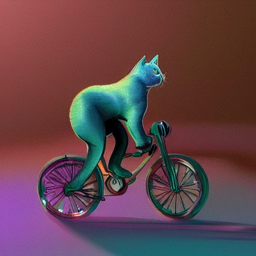

In [30]:
# The embeddings (and a specific seed) will give us the same image as before
image, seed = generate(text_embeddings, seed=1234693494)
show_image(image, seed)

In [10]:
# Now let's define an edit for the above prompt
edit_prompt = "a dog riding a bicycle, highly detailed, trending on artstation, colorful"

In [11]:
# The difference is a single word, how does it look when tokenized?
edit_input = tokenizer(edit_prompt, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
edit_input, edit_input.input_ids.verbose, edit_input.attention_mask.verbose

({'input_ids': tensor[1, 77] n=77 x∈[267.000, 4.941e+04] μ=4.059e+04 σ=1.816e+04 int64 x=..., 'attention_mask': tensor[1, 77] n=77 x∈[0., 1.000] μ=0.221 σ=0.417 int64 x=...},
 tensor[1, 77] n=77 x∈[267.000, 4.941e+04] μ=4.059e+04 σ=1.816e+04 int64
 x=[[49406,   320,  1929,  6765,   320, 11652,   267,  5302, 12609,   267,  6087,
       525,  1486,  2631,   267, 11444, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407]],
 tensor[1, 77] n=77 x∈[0., 1.000] μ=0.221 σ=0.417 int64
 x=[[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
     0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [12]:
# Here's the original prompt
text_input, text_input.input_ids.verbose, text_input.attention_mask.verbose

({'input_ids': tensor[1, 77] n=77 x∈[267.000, 4.941e+04] μ=4.059e+04 σ=1.815e+04 int64 x=..., 'attention_mask': tensor[1, 77] n=77 x∈[0., 1.000] μ=0.221 σ=0.417 int64 x=...},
 tensor[1, 77] n=77 x∈[267.000, 4.941e+04] μ=4.059e+04 σ=1.815e+04 int64
 x=[[49406,   320,  2368,  6765,   320, 11652,   267,  5302, 12609,   267,  6087,
       525,  1486,  2631,   267, 11444, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
     49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407]],
 tensor[1, 77] n=77 x∈[0., 1.000] μ=0.221 σ=0.417 int64
 x=[[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,
     0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

The tokens list is identical except for the changed word from "cat" to "dog". So does that mean we can programmatically replace the the changes to the original token list with the new tokens and if we use the same seed we should get the same image but with a dog? Let's try ...

0it [00:00, ?it/s]

Seed: 1234693494


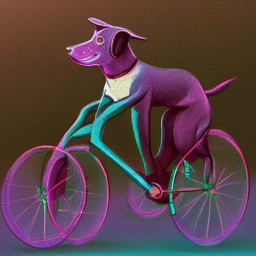

In [34]:
# First get new embeddings for the edit prompt
edit_embeddings = text_encoder(edit_input.input_ids.to(torch_device))[0]
# Now generate the image
image, seed = generate(edit_embeddings, seed=1234693494)
show_image(image, seed)

Nope, didn't work! The basic style is there but the image had more changes than just switching the cat to a dog ... I assume the starting noise (and the direction taken by the diffusion process) is now different even though the seed is the same because the prompt is now different.

What if we started with the original prompt to get the initial noise (and maybe even part of the diffusion process) going and then switched over to the edit prompt? This would require a new `generate` method which takes two prompts (or, as we do in this notebook, two sets of text embeddings).

In [6]:
# Since we'll generate text embeddings multiple times, lets' create a utility method for it
def get_embeddings(prompt: str = ""):
    text_input = tokenizer(prompt, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
    return text_embeddings

In [7]:
# New version of the image generator which takes two embeddings — one for the original prompt 
# and one for the edit prompt — plus a value between 0 to 1 which indicates at what point we switch over 
# to the edited prompt. A value of 0 means we start with the edited prompt, but a value of 1 means that
# the edited prompt is never used.
def generate(text_embeddings, edit_embeddings, edit_at=0.5, width=512, height=512, steps=50, guidance=7.5, seed=None):
    # Do we have a seed?
    if seed is None:
        seed = random.randrange(2 ** 32 - 1)
    generator = torch.manual_seed(seed)
    
    # Prep text 
    unconditioned = get_embeddings()
    text_embeddings = torch.cat([unconditioned, text_embeddings])

    # Prep Scheduler
    scheduler.set_timesteps(steps)

    # When do we switch?
    switch_at = int(steps * edit_at)
    
    # Prep latents
    latents = torch.randn((1, unet.in_channels, height // 8, width // 8), generator=generator)
    latents = latents.to(torch_device)
    latents = latents * scheduler.init_noise_sigma

    # Loop
    with autocast(cast_device):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            # Are we at the switch point?
            if i == switch_at:
                # If yes, switch text embeddings
                text_embeddings = torch.cat([unconditioned, edit_embeddings])
                
            # Expand the latents to avoid doing two forward passes
            model_input = torch.cat([latents] * 2)
            sigma = scheduler.sigmas[i]
            # Scale the latents
            model_input = scheduler.scale_model_input(model_input, t)

            # Predict the noise residual
            with torch.no_grad():
                ts = t
                if torch.has_mps:
                    ts = ts.type(torch.float32)
                noise_pred = unet(model_input, ts, encoder_hidden_states=text_embeddings).sample

            # Perform guidance
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance * (noise_pred_text - noise_pred_uncond)

            # Compute the previous noisy sample x_t -> x_t-1
            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # Get PIL image
    image = image_from_latents(latents)
    return image, seed

Now let's try out the new methods by creating embeddings for the original prompt and its edited version and passing those to the new `generate` method.

0it [00:00, ?it/s]

Seed: 1234693494


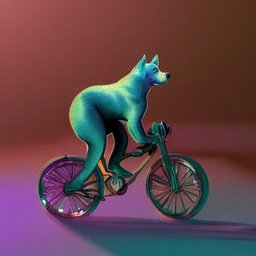

In [24]:
text_embedding = get_embeddings(prompt)
edit_embedding = get_embeddings(edit_prompt)
image, seed = generate(text_embedding, edit_embedding, seed=1234693494)
show_image(image, seed)

Huh, that seems to have worked! I didn't expect it to be that easy! But of course, this is a single case and while it certainly might have worked for this scenario, do we know if it works for other scenarios? I guess more testing is needed ...

Also, wouldn't it be good if we could have all the frames from the image generation so that we can later examine them to see what was going on during the image generation and at what point switching over has the most benefits?

I think this could be helpful. So let's modify the `generate` method to add that and while we are at it, let's also pass actual text prompts to the `generate` methods now ...

In [8]:
# Another version of the image generator which takes the original prompt and the edit prompt as strings 
# It also returns a list of latents for each frame so that we can see all the frames later
def generate(prompt, edit_prompt=None, edit_at=0.5, width=512, height=512, steps=50, guidance=7.5, seed=None):
    # Do we have a seed?
    if seed is None:
        seed = random.randrange(2 ** 32 - 1)
    generator = torch.manual_seed(seed)
    
    # Prep text
    text_embeddings = get_embeddings(prompt)
    if edit_prompt is not None:
        edit_embeddings = get_embeddings(edit_prompt)
        # When do we switch?
        switch_at = int(steps * edit_at)
    unconditioned = get_embeddings()
    text_embeddings = torch.cat([unconditioned, text_embeddings])

    # Prep Scheduler
    scheduler.set_timesteps(steps)
    
    # Save frames for later
    frames = []
    
    # Prep latents
    latents = torch.randn((1, unet.in_channels, height // 8, width // 8), generator=generator)
    latents = latents.to(torch_device)
    latents = latents * scheduler.init_noise_sigma

    # Loop
    with autocast(cast_device):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            # Are we at the switch point?
            if edit_prompt is not None and i == switch_at:
                # If yes, switch text embeddings
                text_embeddings = torch.cat([unconditioned, edit_embeddings])
                
            # Expand the latents to avoid doing two forward passes
            model_input = torch.cat([latents] * 2)
            sigma = scheduler.sigmas[i]
            # Scale the latents
            model_input = scheduler.scale_model_input(model_input, t)

            # Predict the noise residual
            with torch.no_grad():
                ts = t
                if torch.has_mps:
                    ts = ts.type(torch.float32)
                noise_pred = unet(model_input, ts, encoder_hidden_states=text_embeddings).sample

            # Perform guidance
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance * (noise_pred_text - noise_pred_uncond)

            # Compute the previous noisy sample x_t -> x_t-1
            latents = scheduler.step(noise_pred, t, latents).prev_sample
            # Save latent
            frames.append(latents)

    # Get PIL image
    image = image_from_latents(latents)
    return image, seed, frames

0it [00:00, ?it/s]

Seed: 1234693494


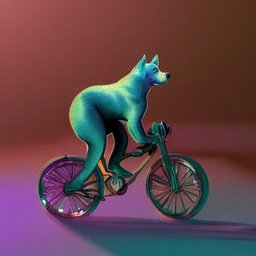

In [61]:
prompt = "a cat riding a bicycle, highly detailed, trending on artstation, colorful"
edit_prompt = "a dog riding a bicycle, highly detailed, trending on artstation, colorful"
image, seed, frames = generate(prompt, edit_prompt, seed=1234693494)
show_image(image, seed)

OK, the new method works. Let's see if we can display the frames individually. We need some more methods for that. To give credit where due, I copied these methods (and modified them as needed) from [arunoda](https://github.com/arunoda)'s repo and attendant notebooks here: https://github.com/arunoda/learn-fastai2-2022/tree/main/sd-deepdive

In [103]:
# Since creating images from the latents is time-consuming, let's hand that off to a separate method
def frames_to_images(frames):
    images = []
    for f in frames:
        img = image_from_latents(f)
        images.append(img)
    return images
        
# Display an array of images in a nice grid, or single row
def image_grid(images, rows = 1, width=256, height=256, title=None):
    count = len(images)
    cols = int(count / rows)
    if cols * rows < count:
        rows += 1
    # Calculate fig size based on individual image sizes    
    px = 1/plt.rcParams['figure.dpi']
    w = cols * width * px
    # Add some extra space for the caption/title since that can wrap
    h = (rows * height * px) + (rows * 30 * px)
    fig, axes = plt.subplots(rows, cols, figsize=(w, h))
    for y in range(rows):
        for x in range(cols):
            index = y*cols + x
            ref = axes[x] if rows == 1 else axes[y] if cols == 1 else axes[y, x]
            ref.axis('off')
            if index > count - 1:
                continue
            img = images[index]
            txt = f'Image: {index}'
            if title is not None:
                if isinstance(title, str):
                    txt = f'{title}: {index}'
                elif isinstance(title, List):
                    txt = title[index]
            # Wrap title if it's really long
            txt = '\n'.join(wrap(txt, width=20))
            ref.title.set_text(txt)
            ref.imshow(img)
            ref.axis('off')

In [33]:
# Let's convert the frames to images separately so that we can modify the grid as we want in the next cell
images = frames_to_images(frames)

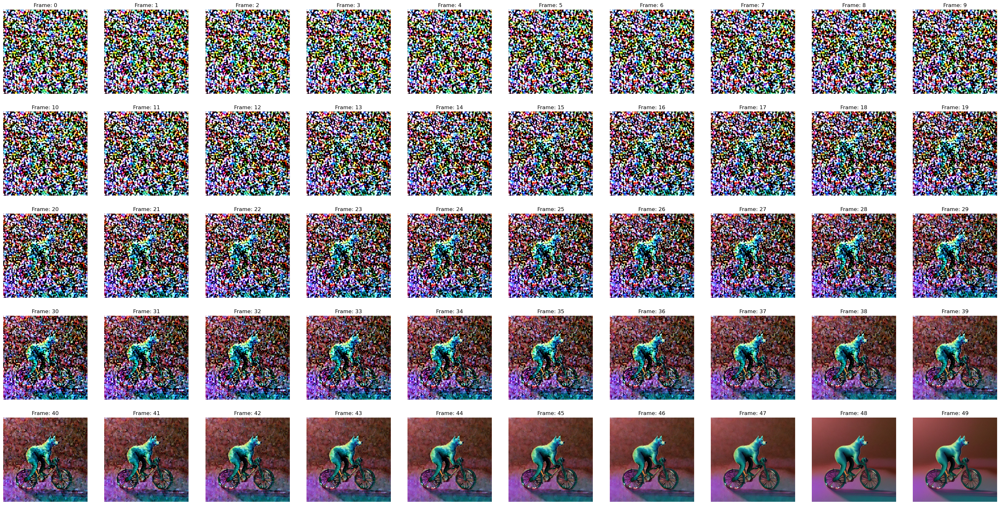

In [43]:
# Now let's display the grid ... with a starting row count of 5?
image_grid(images, rows=5)

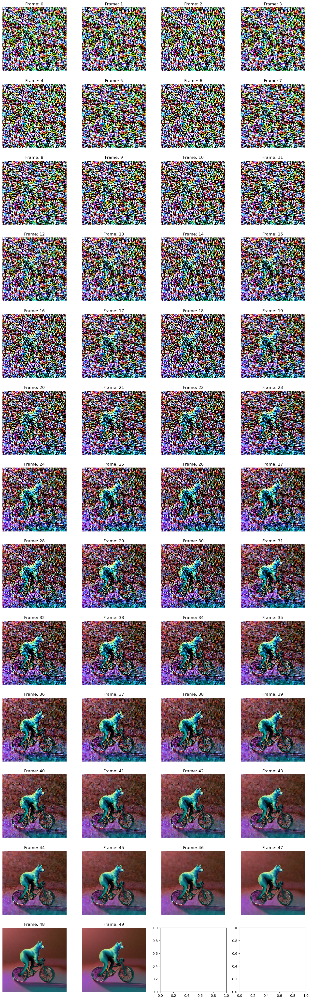

In [49]:
# I think we need a few more rows so that we can see the images more easily ...
image_grid(images, rows=12)

That actually looks good. And possibly useful 😛 Let's try a few other prompts and prompt edits to see if the results are consistent ...

0it [00:00, ?it/s]

Seed: 2224438000


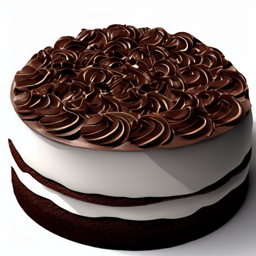

In [69]:
prompt = "A chocolate cake, trending on artstation"
image, seed, frames = generate(prompt)
show_image(image, seed)

0it [00:00, ?it/s]

Seed: 2224438000


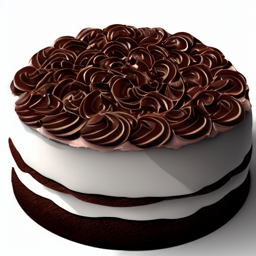

In [71]:
edit_prompt = "A strawberry cake, trending on artstation"
image, seed, frames = generate(prompt, edit_prompt, seed=2224438000)
show_image(image, seed)

Hmm ... that did nothing. What if we change the point at which the edit prompt becomes effective by changing the `edit_at` parameter? Let's try switching over to the edit prompt earlier on ...

0it [00:00, ?it/s]

Seed: 2224438000


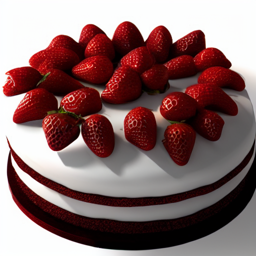

In [72]:
edit_prompt = "A strawberry cake, trending on artstation"
image, seed, frames = generate(prompt, edit_prompt, edit_at=0.2, seed=2224438000)
show_image(image, seed)

That isn't exactly the same cake but overall isn't it close enough? I guess we need a subject that's a bit more complex?

0it [00:00, ?it/s]

Seed: 2397978312


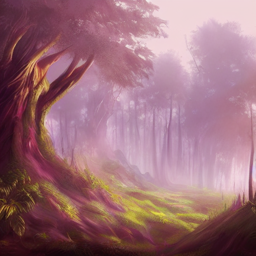

In [74]:
prompt = "A fantasy forest, trending on artstation"
image, seed, frames = generate(prompt)
show_image(image, seed)

0it [00:00, ?it/s]

Seed: 2397978312


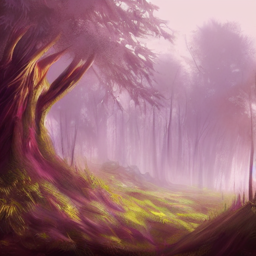

In [75]:
edit_prompt = "A fantasy forest in winter, trending on artstation"
image, seed, frames = generate(prompt, edit_prompt, seed=2397978312)
show_image(image, seed)

0it [00:00, ?it/s]

Seed: 2397978312


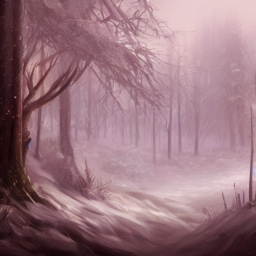

In [77]:
edit_prompt = "A fantasy forest in winter, trending on artstation"
image, seed, frames = generate(prompt, edit_prompt, edit_at=0.2, seed=2397978312)
show_image(image, seed)

Still the same as before nothing happens with the default `edit_at` value of `0.5` but it does appear to work for an `edit_at` value of `0.2`. Plus, this time around we weren't just replacing a word but adding a new concept and it still seems to work ...

But are these just accidents? Or is this acutally working correctly?

Let's try some prompts directly from [this Cross Attention Control implementation](https://github.com/bloc97/CrossAttentionControl/) on GitHub and see if that prompt works for this approach ...

0it [00:00, ?it/s]

Seed: 3626480673


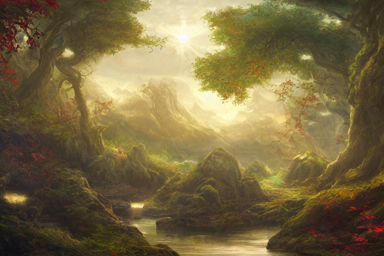

In [79]:
prompt = "a fantasy landscape with a maple forest"
image, seed, frames = generate(prompt, width=768)
show_image(image, seed)

0it [00:00, ?it/s]

Seed: 3626480673


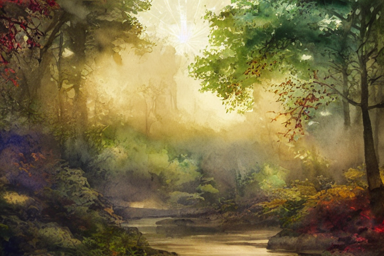

In [81]:
edit_prompt = "a watercolor painting of a fantasy landscape with a maple forest"
image, seed, frames = generate(prompt, edit_prompt, edit_at=0.2, width=768, seed=3626480673)
show_image(image, seed)

0it [00:00, ?it/s]

Seed: 3626480673


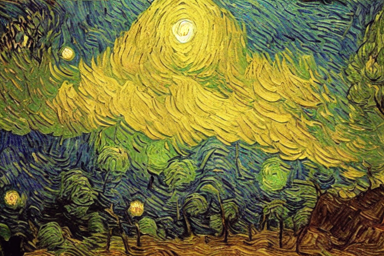

In [82]:
edit_prompt = "a van gogh painting of a fantasy landscape with a maple forest"
image, seed, frames = generate(prompt, edit_prompt, edit_at=0.2, width=768, seed=3626480673)
show_image(image, seed)

0it [00:00, ?it/s]

Seed: 3626480673


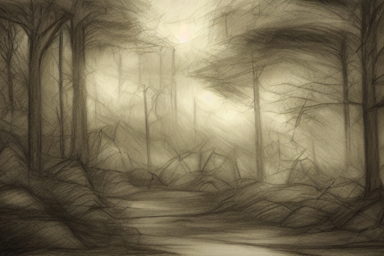

In [83]:
edit_prompt = "a charcoal pencil sketch of a fantasy landscape with a maple forest"
image, seed, frames = generate(prompt, edit_prompt, edit_at=0.2, width=768, seed=3626480673)
show_image(image, seed)

Let's try the fruitbowl example from the [DiffEdit paper](https://arxiv.org/pdf/2210.11427.pdf) to see if that works here ...

0it [00:00, ?it/s]

Seed: 2625148849


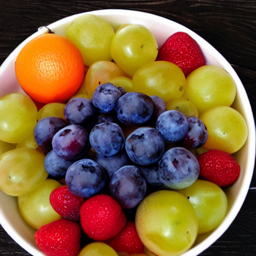

In [30]:
prompt = "a bowl of fruit"
image, seed, frames = generate(prompt)
show_image(image, seed)

Good seeds to try: 961671476, 2625148849, 736044989, 1349086860

The one used below: 2625148849

0it [00:00, ?it/s]

Seed: 2625148849


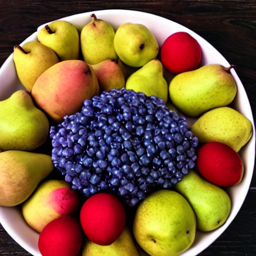

In [22]:
edit_prompt = "a bowl of pears"
img1, s, frames = generate(prompt, edit_prompt, edit_at=0.2, seed=seed)
show_image(img1, s)

0it [00:00, ?it/s]

Seed: 2625148849


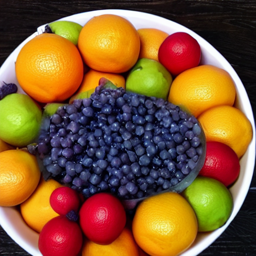

In [23]:
edit_prompt = "a bowl of oranges"
img2, s, frames = generate(prompt, edit_prompt, edit_at=0.2, seed=seed)
show_image(img2, s)

0it [00:00, ?it/s]

Seed: 2625148849


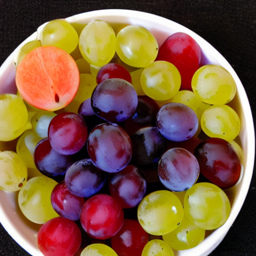

In [24]:
edit_prompt = "a bowl of grapes"
img3, s, frames = generate(prompt, edit_prompt, edit_at=0.2, seed=seed)
show_image(img3, s)

0it [00:00, ?it/s]

Seed: 2625148849


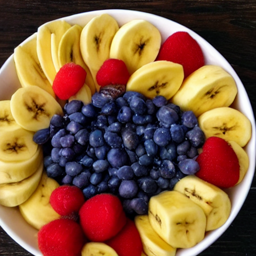

In [41]:
edit_prompt = "a bowl of bananas"
img4, s, frames = generate(prompt, edit_prompt, edit_at=0.2, seed=seed)
show_image(img4, s)

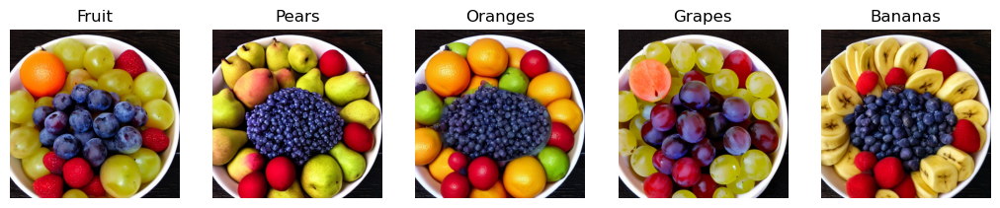

In [42]:
image_grid([image, img1, img2, img3, img4], title=['Fruit', 'Pears', 'Oranges', 'Grapes', 'Bananas'])

Let's create a test harness so that the same code can be run over and over with the prompt, resulting image, and any other important data is automatically saved instead of me manually editing every cell to give new variable names ...

In [50]:
def harness(prompt, edit_prompt = None, edit_at = 0.2, seed=None):
    image, seed, frames = generate(prompt, edit_prompt = edit_prompt, edit_at = edit_at, seed = seed)
    images.append(image)
    if edit_prompt is not None:
        prompts.append(edit_prompt)
    else:
        prompts.append(prompt)
    show_image(image, seed)
    return seed

0it [00:00, ?it/s]

Seed: 778735961


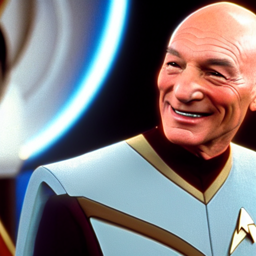

In [59]:
# Start a new series of tests
images = []
prompts = []
prompt = 'picard smiling, a scene from star trek tng'
seed = harness(prompt)

0it [00:00, ?it/s]

Seed: 778735961


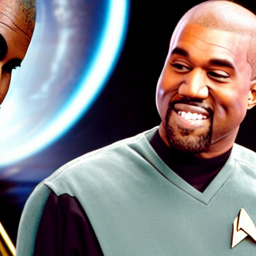

778735961

In [75]:
edit_prompt = 'kanye west smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


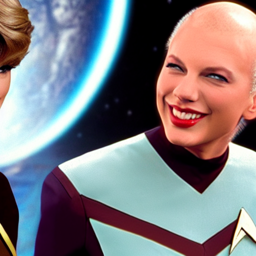

778735961

In [79]:
edit_prompt = 'taylor swift smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


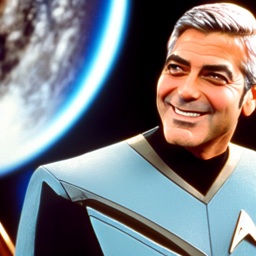

778735961

In [80]:
edit_prompt = 'george clooney smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


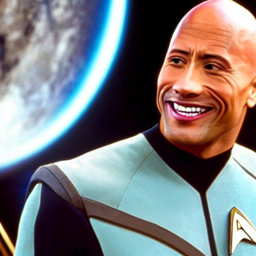

778735961

In [81]:
edit_prompt = 'dwayne johnson smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


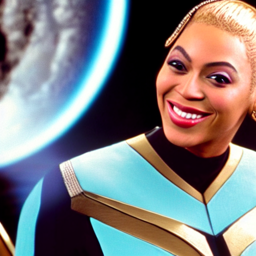

778735961

In [82]:
edit_prompt = 'beyonce smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


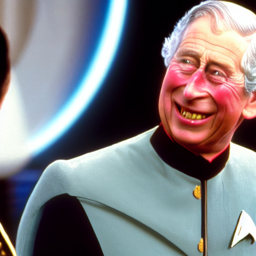

778735961

In [85]:
edit_prompt = 'prince charles smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


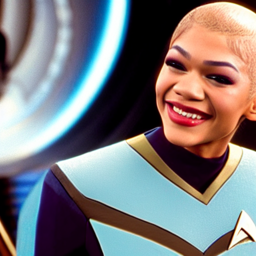

778735961

In [88]:
edit_prompt = 'zendaya smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


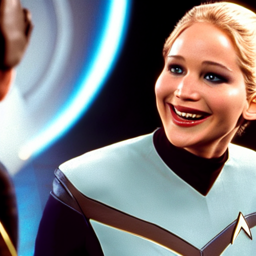

778735961

In [91]:
edit_prompt = 'jennifer lawrence smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


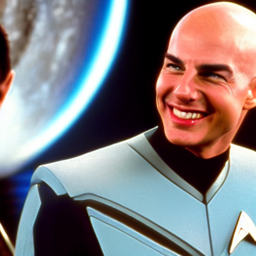

778735961

In [92]:
edit_prompt = 'tom cruise smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


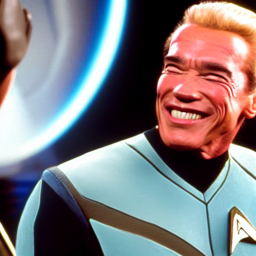

778735961

In [95]:
edit_prompt = 'arnold schwarzenegger smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


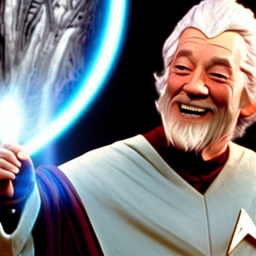

778735961

In [96]:
edit_prompt = 'gandalf the wizard smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


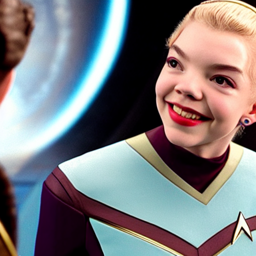

778735961

In [97]:
edit_prompt = 'anya taylor-joy smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


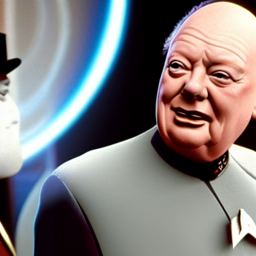

778735961

In [108]:
edit_prompt = 'winston churchill smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


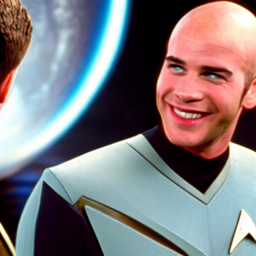

778735961

In [109]:
edit_prompt = 'liam hemsworth smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 778735961


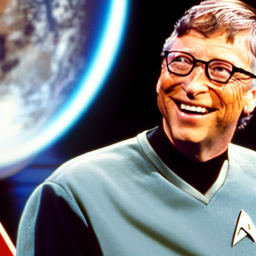

778735961

In [110]:
edit_prompt = 'bill gates smiling, a scene from star trek tng'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

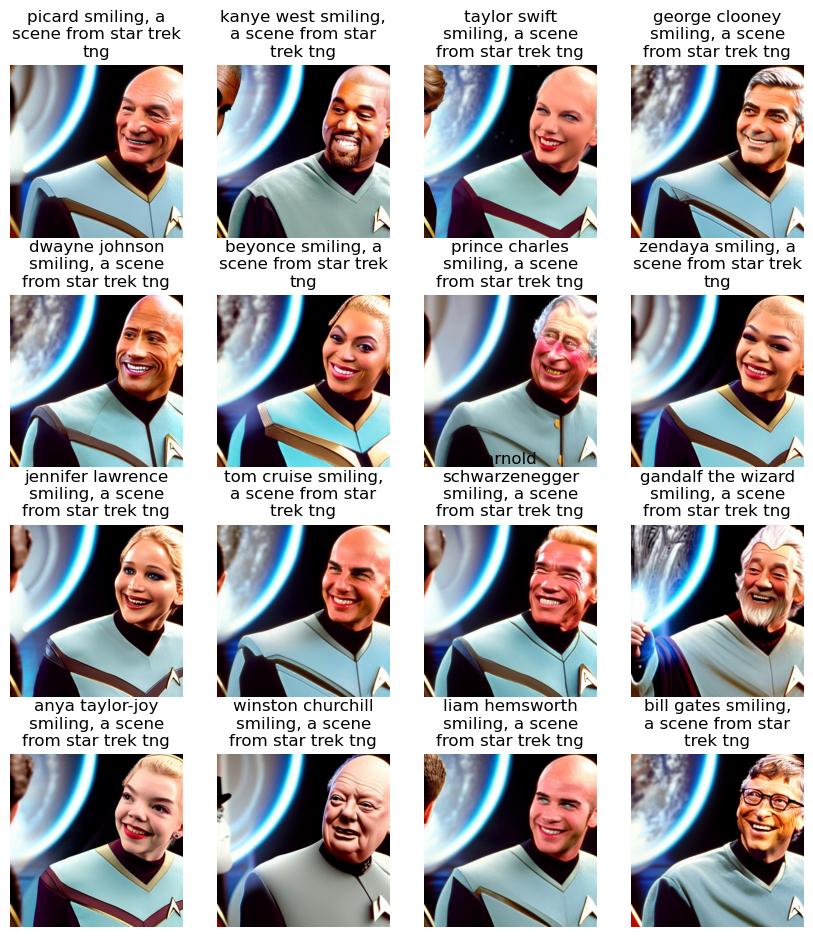

In [113]:
image_grid(images, title=prompts, rows=4)

0it [00:00, ?it/s]

Seed: 4091876595


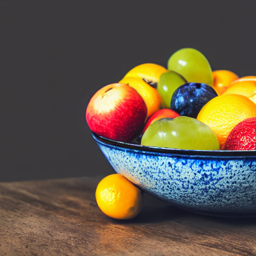

In [124]:
# Start a new series of tests
images = []
prompts = []
prompt = 'a bowl of fruit, DSLR photo'
# Good seeds - 3375826186, 4091876595
seed = harness(prompt)

0it [00:00, ?it/s]

Seed: 4091876595


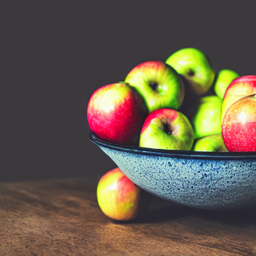

4091876595

In [125]:
edit_prompt = 'a bowl of apples, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


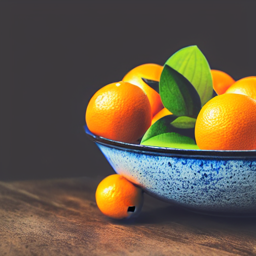

4091876595

In [126]:
edit_prompt = 'a bowl of oranges, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


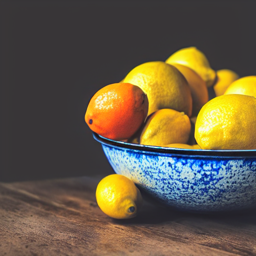

4091876595

In [127]:
edit_prompt = 'a bowl of lemons, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


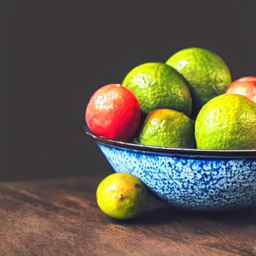

4091876595

In [128]:
edit_prompt = 'a bowl of limes, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


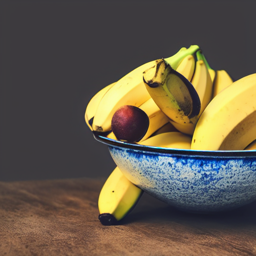

4091876595

In [129]:
edit_prompt = 'a bowl of bananas, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


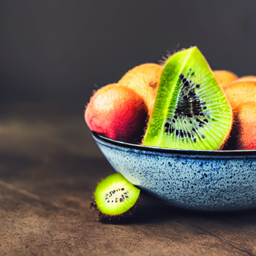

4091876595

In [130]:
edit_prompt = 'a bowl of kiwi fruit, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


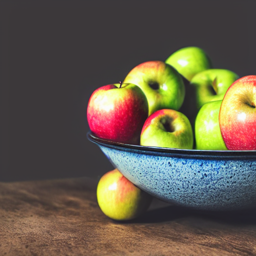

4091876595

In [131]:
edit_prompt = 'a bowl of granny smith apples, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


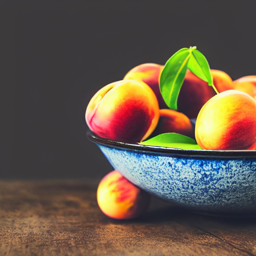

4091876595

In [132]:
edit_prompt = 'a bowl of nectarines, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


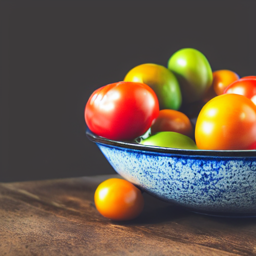

4091876595

In [133]:
edit_prompt = 'a bowl of heirloom tomatoes, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


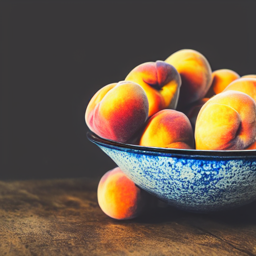

4091876595

In [134]:
edit_prompt = 'a bowl of peaches, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


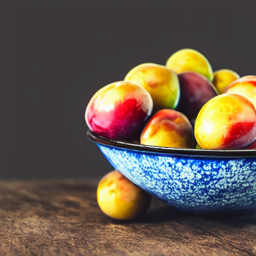

4091876595

In [135]:
edit_prompt = 'a bowl of plums, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


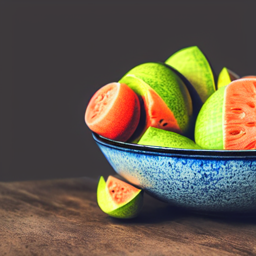

4091876595

In [136]:
edit_prompt = 'a bowl of canteloupe melons, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


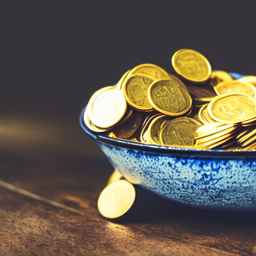

4091876595

In [137]:
edit_prompt = 'a bowl of gold coins, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


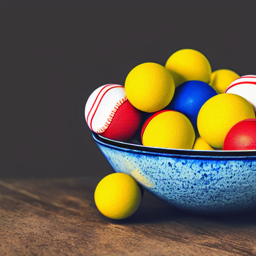

4091876595

In [139]:
edit_prompt = 'a bowl of baseballs, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

0it [00:00, ?it/s]

Seed: 4091876595


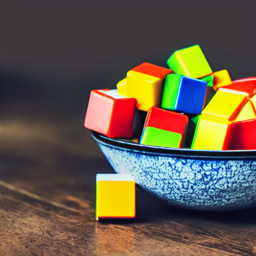

4091876595

In [140]:
edit_prompt = 'a bowl of rubiks cubes, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

In [ ]:
edit_prompt = 'a bowl of apples, DSLR photo'
harness(prompt, edit_prompt = edit_prompt, seed=seed)

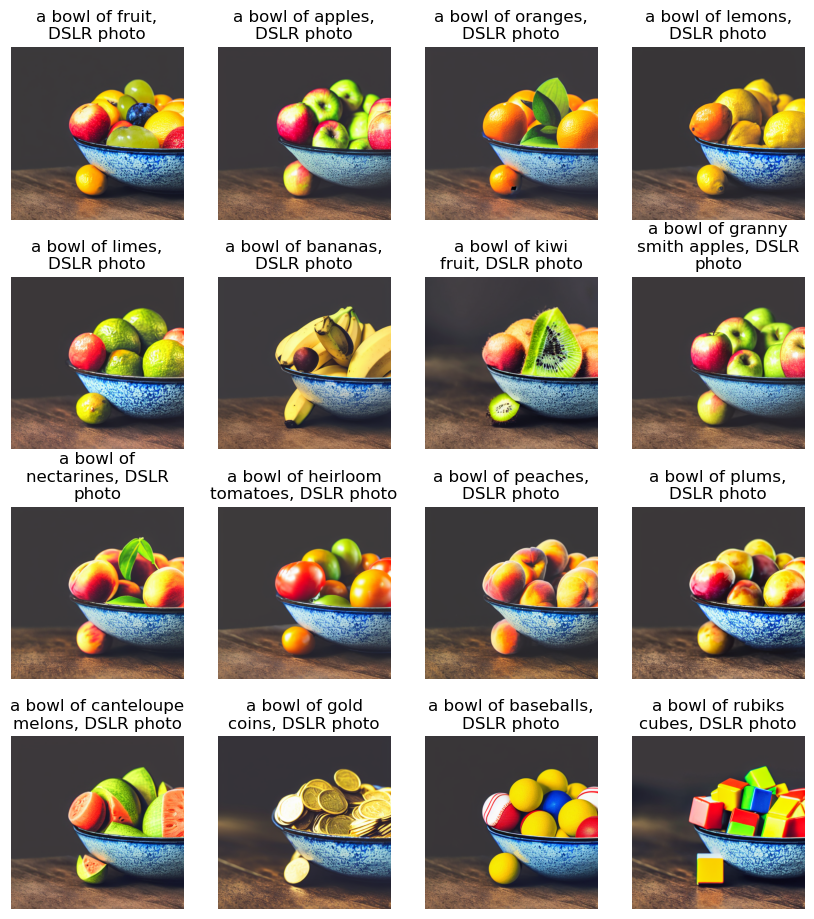

In [141]:
image_grid(images, title=prompts, rows=4)